In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from imports import *
# from process_data import *
from train import *
from datasets import *

In [3]:
# tiling_data = DNASeqGraph("/Users/Brody1/Documents/Northwestern/DNA_Cyclizability/benchmarks/gnns", 
#                           raw_graph_name="cycle5", processed_graph_name="cycle5_1_2_3_4_9_14_19_24_edge_together", 
#                           edge_distances=[1,2,3,4,9,14,19,24])
# random_data = DNASeqGraph("/Users/Brody1/Documents/Northwestern/DNA_Cyclizability/benchmarks/gnns", 
#                           raw_graph_name="cycle3", processed_graph_name="cycle3_1_2_3_4_9_14_19_24_edge_together", 
#                           edge_distances=[1,2,3,4,9,14,19,24])

In [4]:
tiling_data = DNASeqGraphSeparateEdges("/Users/Brody1/Documents/Northwestern/DNA_Cyclizability/benchmarks/gnns", 
                                       raw_graph_name="cycle5", 
                                       processed_graph_name="cycle5_1_5_10_15_edge_separate_include_indices", 
                                       edge_distances=[1,5,10,15],
                                       include_indices=True)

Processing...
Done!


In [5]:
tiling_data[0].edge_index[:,tiling_data[0].edge_index_15_locations]

tensor([[ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 15,
         16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
         34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49],
        [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
         33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49,  0,
          1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
         19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34]])

In [12]:
cluster_list = [
    torch.Tensor(
        [0,0,0,0,0,1,1,1,1,1,2,2,2,2,2,3,3,3,3,3,4,4,4,4,4,5,5,5,5,5,6,6,6,6,6,7,7,7,7,7,8,8,8,8,8,9,9,9,9,9]),
    torch.Tensor(
        [0,0,1,1,2,2,3,3,4,4])
]
len(cluster_list[1])

12

In [6]:
hyperparameters = {"hidden_channels":32, "num_layers":[3], "num_epochs":20, "learning_rate":0.0001, "batch_size":32,
                   "pool_ratios":[], "pool_types":[], "mlp_num_layers":2, "edge_lengths":[1,5,10,15], "mp_layer":GCN,
                   "jk":"lstm"}
logging_info = {"print_every":1, "folder_path":"/Users/Brody1/Documents/Northwestern/DNA_Cyclizability/benchmarks/gnns/",
                "file_name": "edge_separate_1_5_10_15_no_pooling_GCN_3layer_include_indices"}

model, train_loss, val_loss, val_corr = train(tiling_data, hyperparameters=hyperparameters, logging_info=logging_info, 
                                              model_name="GraphSAGESeparateEdgeLengths", val_data=random_data, 
                                              plot_0_val=False)

End of epoch: 0. Total run time: 627 seconds
	 Train loss: 0.2545905135305658
	 Randomly selected predicted value: tensor([[-0.1176]]), true value: tensor([[-0.2190]])
	 Randomly selected predicted value: tensor([[-0.0239]]), true value: tensor([[-0.2622]])
	 Randomly selected predicted value: tensor([[-0.0787]]), true value: tensor([[-0.3236]])
	 Randomly selected predicted value: tensor([[-0.0031]]), true value: tensor([[-0.0956]])
	 Randomly selected predicted value: tensor([[-0.1058]]), true value: tensor([[0.5298]])
	 Randomly selected predicted value: tensor([[0.0374]]), true value: tensor([[-0.2565]])
	 Validation loss: 0.14895610094001302
	 Validation Correlation: 0.05951739223723231
End of epoch: 1. Total run time: 1349 seconds
	 Train loss: 0.23024836383765765
	 Randomly selected predicted value: tensor([[-0.2496]]), true value: tensor([[-0.7441]])
	 Randomly selected predicted value: tensor([[0.0362]]), true value: tensor([[-0.1103]])
	 Randomly selected predicted value: ten

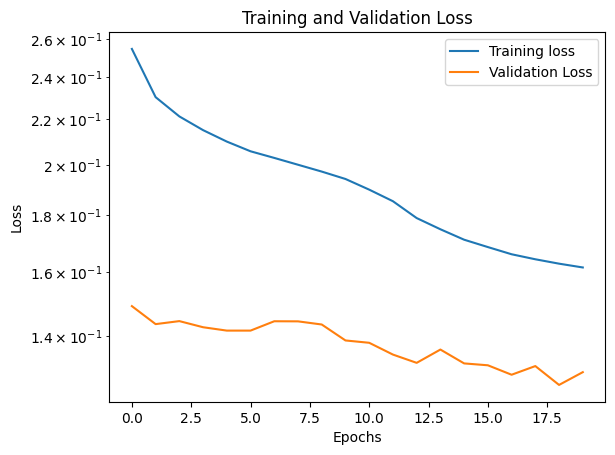

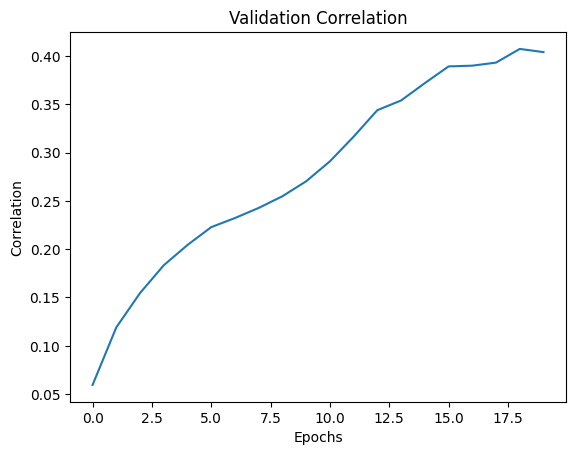

In [7]:
plt.plot(train_loss, label="Training loss")
plt.plot(val_loss, label="Validation Loss")
plt.title("Training and Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.yscale("log")
plt.legend()
plt.show()

plt.plot(val_corr, label="Validation Correlation")
plt.title("Validation Correlation")
plt.xlabel("Epochs")
plt.ylabel("Correlation")
plt.show()

In [4]:
# hyperparameters = {"hidden_channels":32, "num_layers":[3], "num_epochs":20, "learning_rate":0.00001, "batch_size":32,
#                    "pool_ratios":[], "pool_types":[], "mlp_num_layers":2, "edge_lengths":[1,6,11,16,21,26], "mp_layer":GCN,
#                    "jk":"lstm"}
# model = GraphSAGESeparateEdgeLengths(num_node_features=4, hidden_channels=hyperparameters["hidden_channels"], 
#                                      num_layers=hyperparameters["num_layers"], output_features=1, 
#                                      pool_ratios=hyperparameters["pool_ratios"], pool_types=hyperparameters["pool_types"], 
#                                      mlp_num_layers=hyperparameters["mlp_num_layers"], edge_lengths=hyperparameters["edge_lengths"],
#                                      jk=hyperparameters["jk"], mp_layer=hyperparameters["mp_layer"])
# model.load_state_dict(torch.load(logging_info["folder_path"] + "models/" + logging_info["file_name"]))

<All keys matched successfully>

1000 predictions:
	 Correlation: 0.37118003566794877


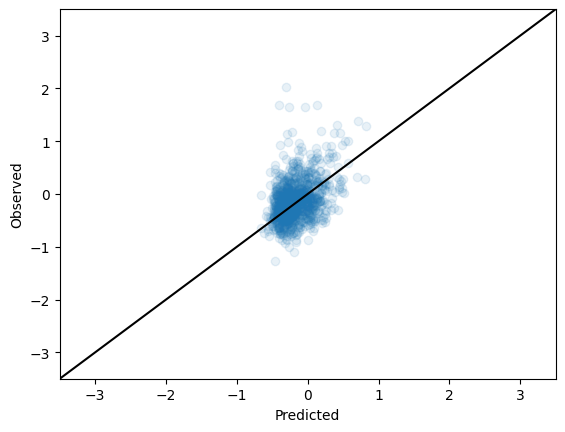

2000 predictions:
	 Correlation: 0.39484356112374963


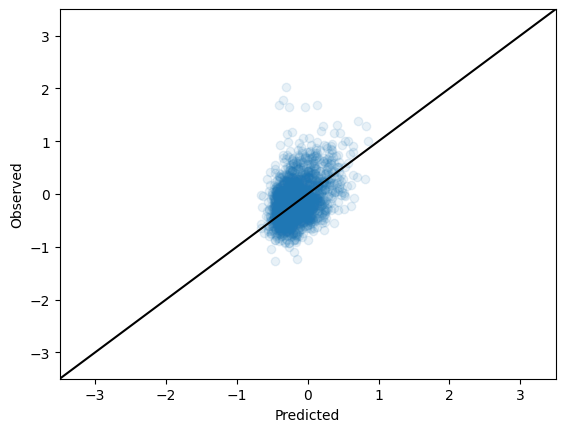

3000 predictions:
	 Correlation: 0.4020682108620366


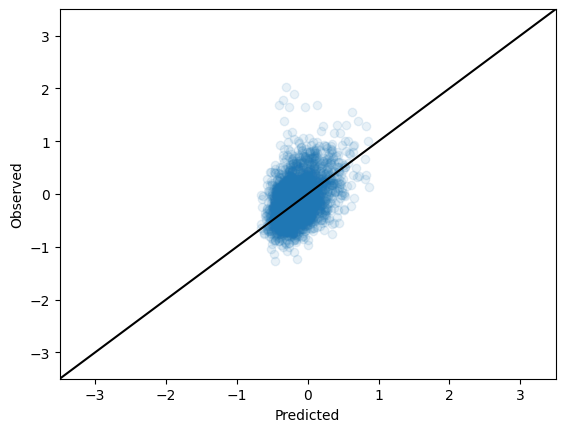

4000 predictions:
	 Correlation: 0.4080893416005437


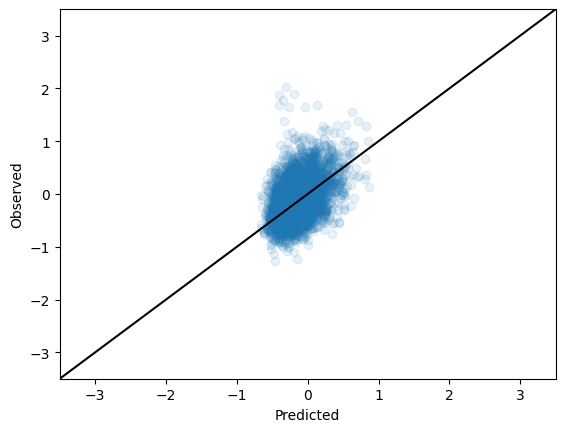

5000 predictions:
	 Correlation: 0.4044281641819129


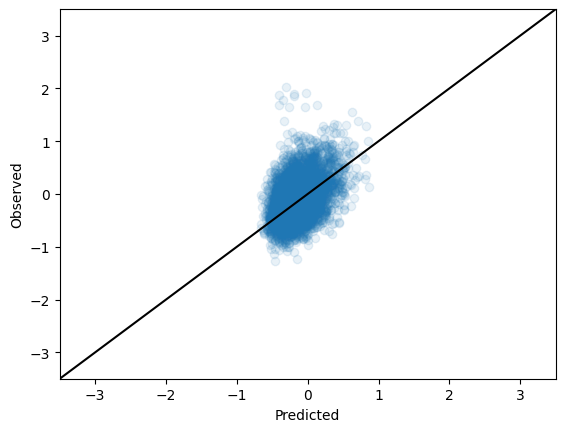

KeyboardInterrupt: 

In [8]:
model.eval()
random_loader = DataLoader(random_data, batch_size=1)
random_pred = []
random_obs = []

x = [-3.5, 3.5]
y = [-3.5, 3.5]

with torch.no_grad():
    for i, random_batch in enumerate(random_loader):
        random_pred.append(model(random_batch).item())
        random_obs.append(random_batch.y.item())
        # print(f"Sequence number {i} \n \t prediction: {random_pred[i].item()} \n \t observed: {random_batch.y.item()}")
        if i % 1000 == 999:
            print(f"{i+1} predictions:")
            print(f"\t Correlation: {np.corrcoef((random_pred, random_obs))[0,1]}")
            plt.xlim(x)
            plt.ylim(y)
            plt.xlabel("Predicted")
            plt.ylabel("Observed")
            plt.plot(x, y, color="black")
            plt.scatter(random_pred, random_obs, marker="o", alpha=0.1)
            plt.pause(0.00001)

1000 predictions:
	 Correlation: 0.49174834137165796


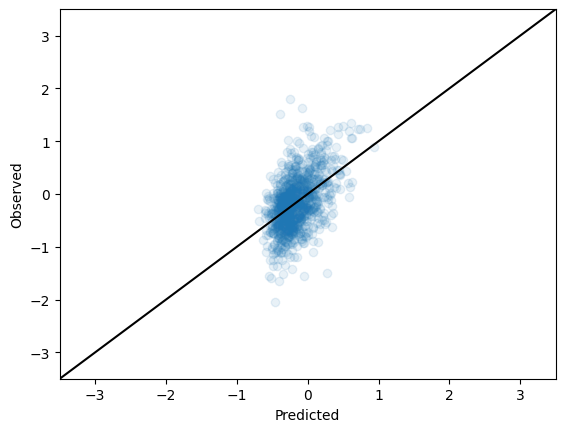

2000 predictions:
	 Correlation: 0.4814856789437843


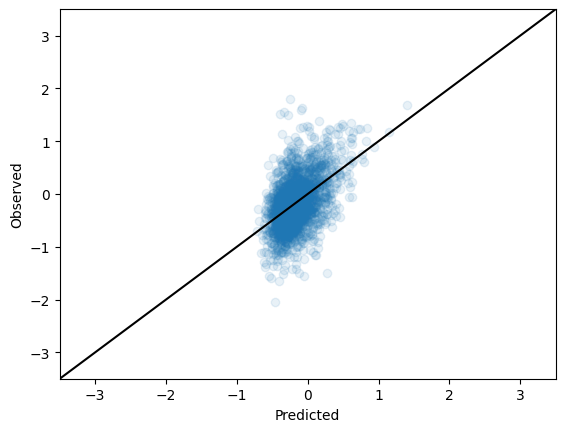

3000 predictions:
	 Correlation: 0.46741215070279235


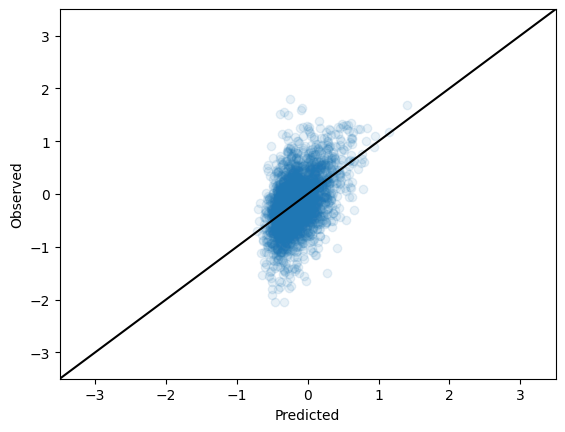

4000 predictions:
	 Correlation: 0.47595689923708984


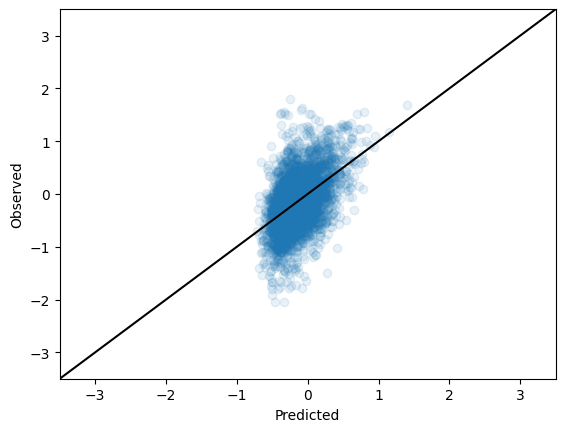

KeyboardInterrupt: 

In [9]:
model.eval()
tiling_loader = DataLoader(tiling_data, batch_size=1)
tiling_pred = []
tiling_obs = []

x = [-3.5, 3.5]
y = [-3.5, 3.5]

with torch.no_grad():
    for i, tiling_batch in enumerate(tiling_loader):
        tiling_pred.append(model(tiling_batch).item())
        tiling_obs.append(tiling_batch.y.item())
        # print(f"Sequence number {i} \n \t prediction: {tiling_pred[i].item()} \n \t observed: {tiling_batch.y.item()}")
        if i % 1000 == 999:
            print(f"{i+1} predictions:")
            print(f"\t Correlation: {np.corrcoef((tiling_pred, tiling_obs))[0,1]}")
            plt.xlim(x)
            plt.ylim(y)
            plt.xlabel("Predicted")
            plt.ylabel("Observed")
            plt.plot(x, y, color="black")
            plt.scatter(tiling_pred, tiling_obs, marker="o", alpha=0.1)
            plt.pause(0.00001)

End of epoch: 0. Total run time: 194 seconds
	 Train loss: 7.804843179117411


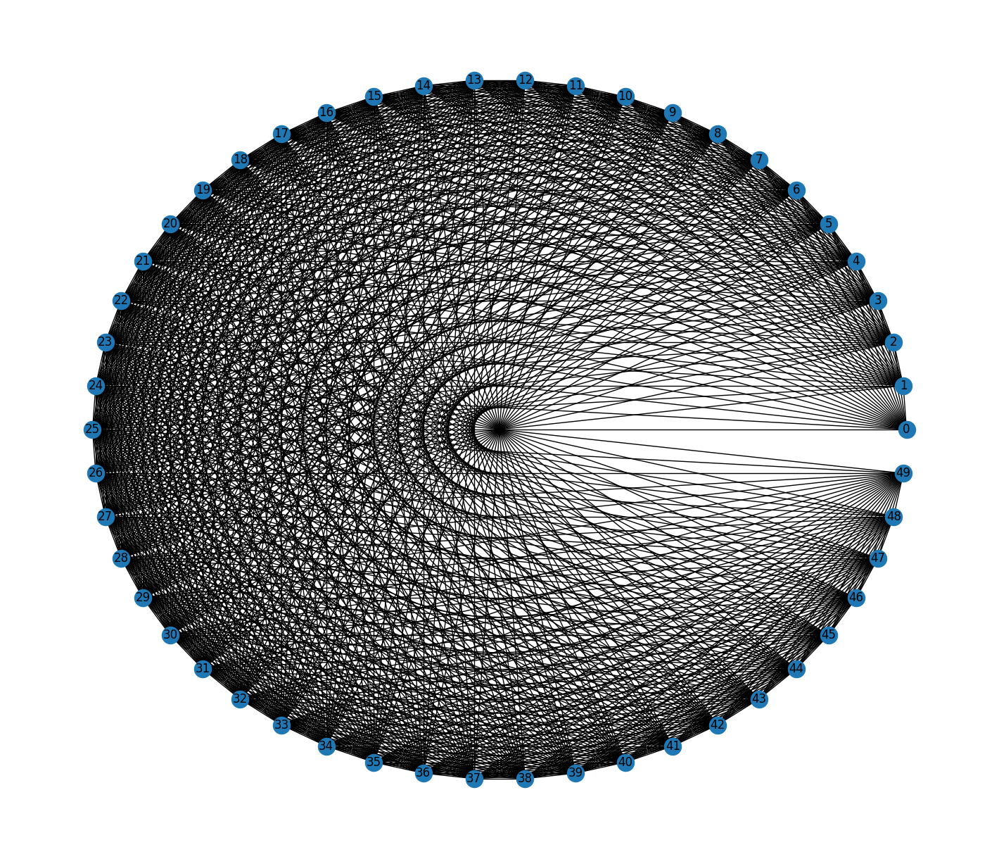

	 Randomly selected predicted value: tensor([[-0.7568]]), true value: tensor([[0.1622]])
	 Randomly selected predicted value: tensor([[-0.3044]]), true value: tensor([[-0.2082]])
	 Randomly selected predicted value: tensor([[-0.5331]]), true value: tensor([[-0.4676]])
	 Validation loss: 0.2350244116496485
	 Validation Correlation: 0.010483828626472824
End of epoch: 1. Total run time: 481 seconds
	 Train loss: 0.2485534561559176


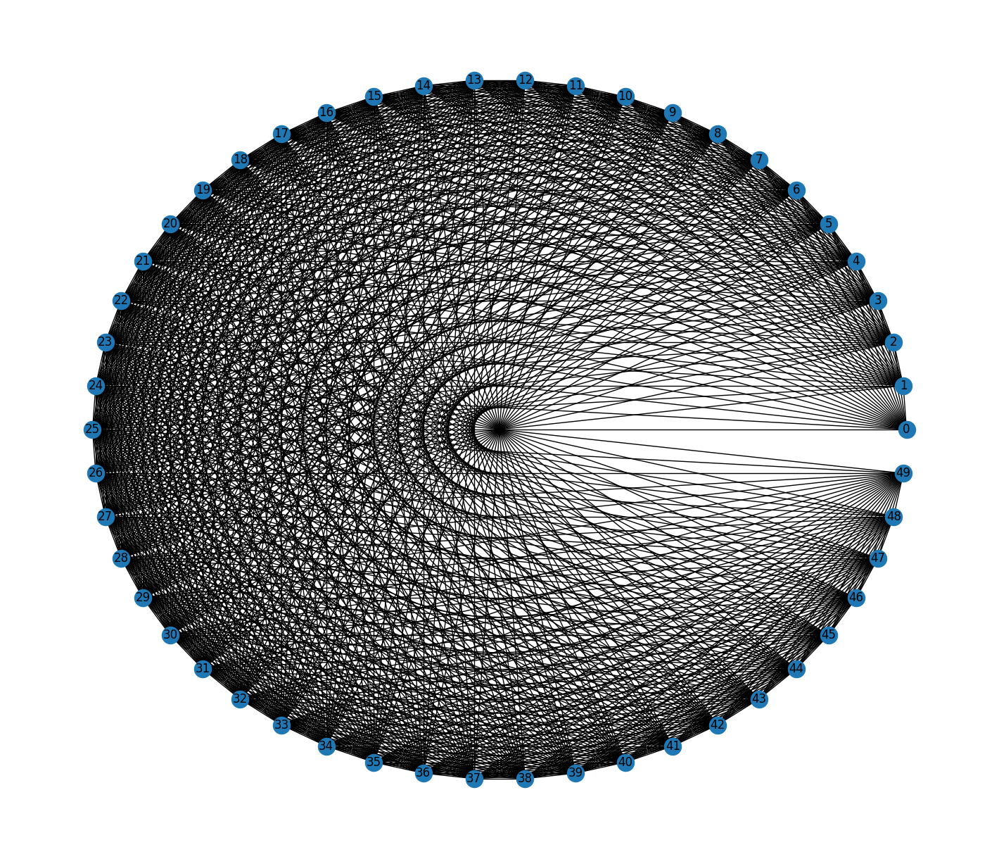

	 Randomly selected predicted value: tensor([[-0.1611]]), true value: tensor([[-0.2404]])
	 Randomly selected predicted value: tensor([[0.3465]]), true value: tensor([[-0.1441]])
	 Randomly selected predicted value: tensor([[0.1379]]), true value: tensor([[-0.3695]])
	 Randomly selected predicted value: tensor([[-0.0618]]), true value: tensor([[-0.1313]])
	 Randomly selected predicted value: tensor([[-0.1744]]), true value: tensor([[0.1868]])
	 Randomly selected predicted value: tensor([[0.1912]]), true value: tensor([[-0.1736]])
	 Randomly selected predicted value: tensor([[0.2829]]), true value: tensor([[-0.3252]])
	 Validation loss: 0.23315168459242233
	 Validation Correlation: 0.012674520160077507
End of epoch: 2. Total run time: 769 seconds
	 Train loss: 0.2200271121202371


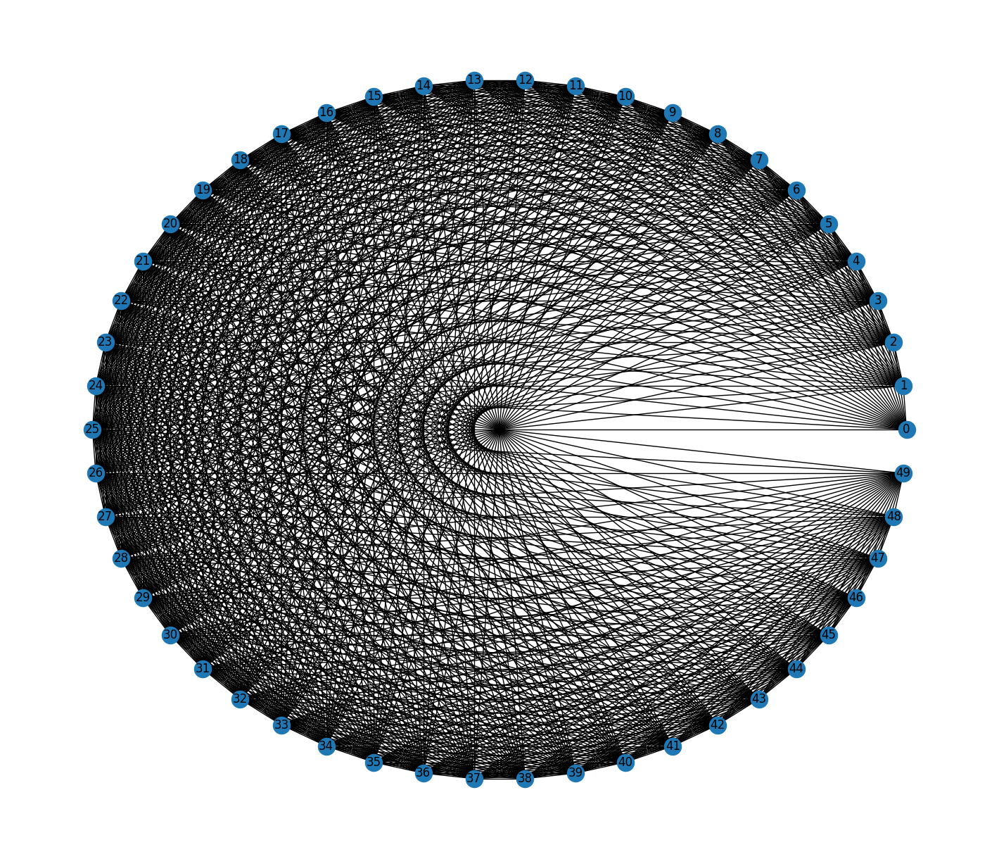

	 Randomly selected predicted value: tensor([[-0.1387]]), true value: tensor([[0.3944]])
	 Validation loss: 0.17784647590230604
	 Validation Correlation: 0.017812440339962484
End of epoch: 3. Total run time: 1056 seconds
	 Train loss: 0.19961757275920647


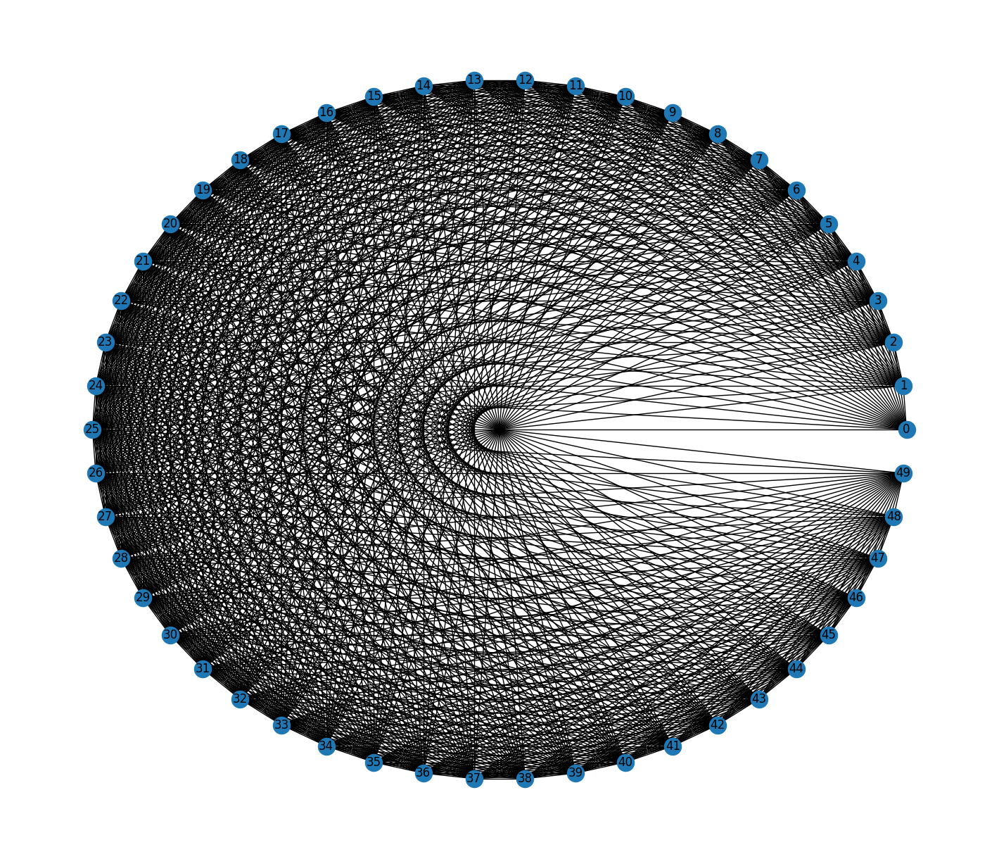

	 Randomly selected predicted value: tensor([[-0.0518]]), true value: tensor([[-0.4350]])
	 Randomly selected predicted value: tensor([[-0.1660]]), true value: tensor([[0.7385]])
	 Randomly selected predicted value: tensor([[0.1210]]), true value: tensor([[-0.1514]])
	 Randomly selected predicted value: tensor([[-0.0646]]), true value: tensor([[-0.4124]])
	 Randomly selected predicted value: tensor([[0.1356]]), true value: tensor([[-0.2904]])
	 Validation loss: 0.17359371234092358
	 Validation Correlation: 0.02299788773028185
End of epoch: 4. Total run time: 1344 seconds
	 Train loss: 0.18507949274319868


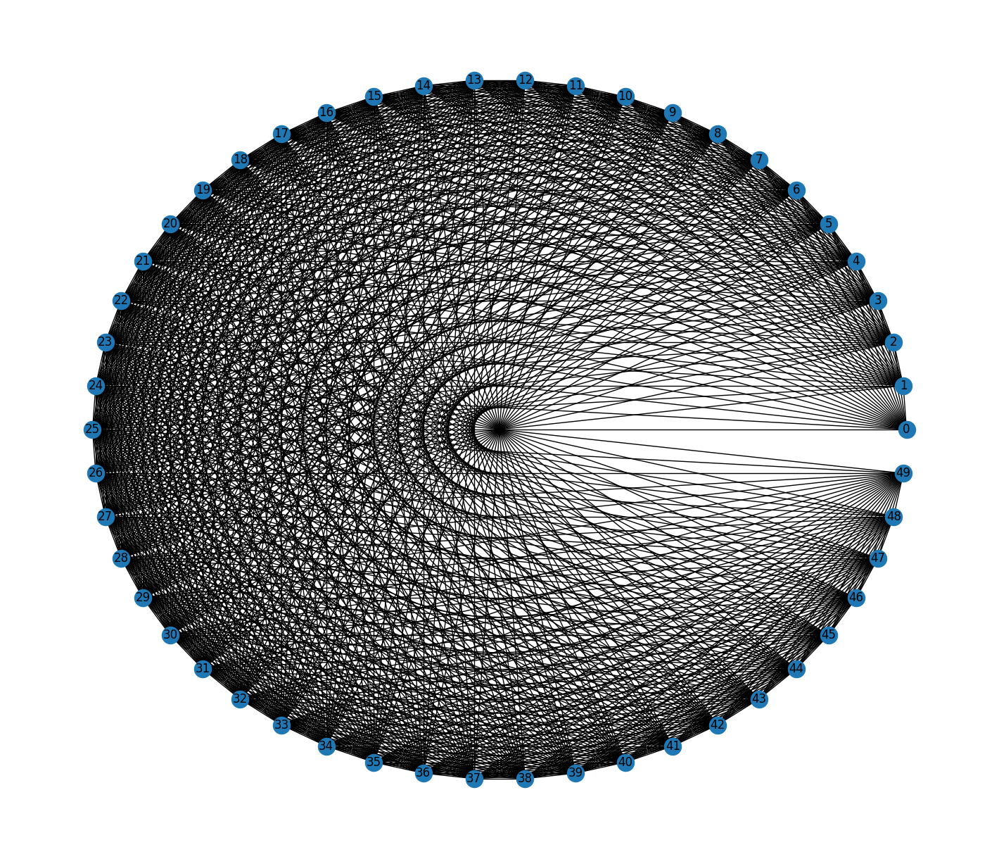

	 Randomly selected predicted value: tensor([[-0.0308]]), true value: tensor([[0.0586]])
	 Randomly selected predicted value: tensor([[-0.2601]]), true value: tensor([[0.0198]])
	 Randomly selected predicted value: tensor([[-0.2074]]), true value: tensor([[0.0495]])
	 Randomly selected predicted value: tensor([[0.0055]]), true value: tensor([[-0.2401]])
	 Randomly selected predicted value: tensor([[-0.2431]]), true value: tensor([[-0.6438]])
	 Randomly selected predicted value: tensor([[-0.3238]]), true value: tensor([[-0.3784]])
	 Validation loss: 0.1647966429089177
	 Validation Correlation: 0.018515743775899145
End of epoch: 5. Total run time: 1631 seconds
	 Train loss: 0.17728791639972954


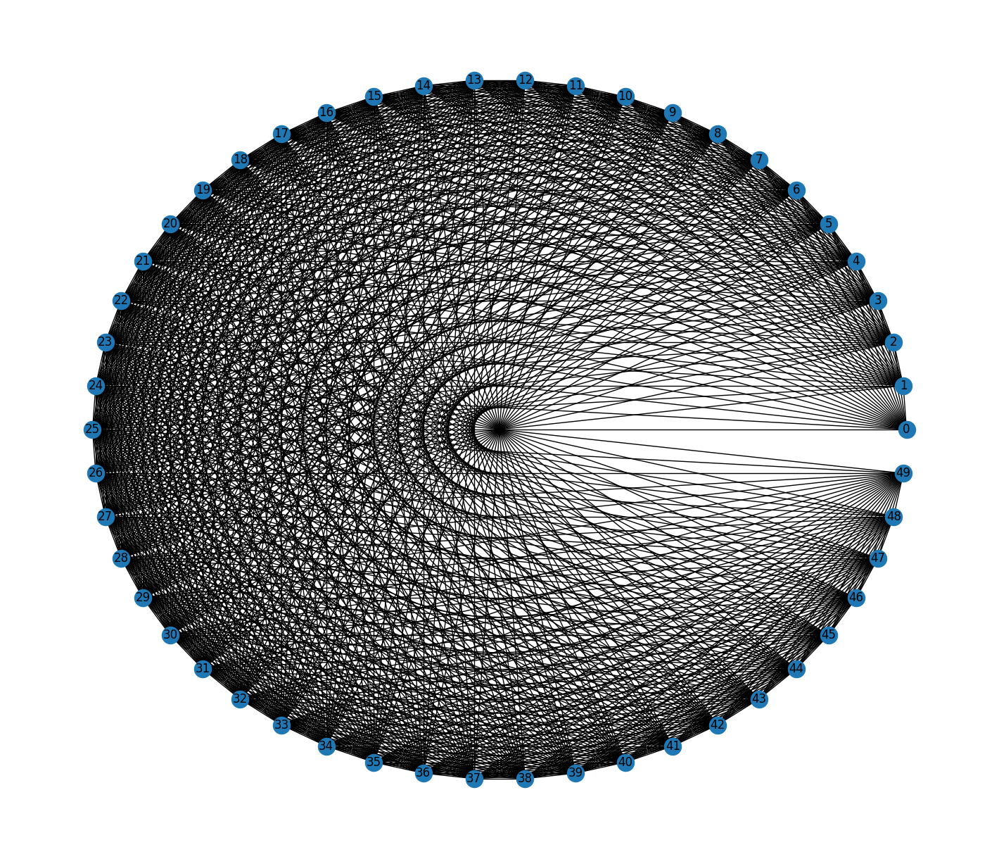

	 Randomly selected predicted value: tensor([[-0.0842]]), true value: tensor([[0.1746]])
	 Randomly selected predicted value: tensor([[-0.0573]]), true value: tensor([[0.2722]])
	 Randomly selected predicted value: tensor([[0.1422]]), true value: tensor([[-0.3098]])
	 Randomly selected predicted value: tensor([[-0.1030]]), true value: tensor([[-0.3317]])
	 Randomly selected predicted value: tensor([[-0.1495]]), true value: tensor([[-0.2616]])
	 Randomly selected predicted value: tensor([[-0.0756]]), true value: tensor([[0.6764]])
	 Randomly selected predicted value: tensor([[-0.0055]]), true value: tensor([[0.0363]])
	 Randomly selected predicted value: tensor([[-0.1624]]), true value: tensor([[0.3256]])
	 Validation loss: 0.16035586858130754
	 Validation Correlation: 0.02809960356061073
End of epoch: 6. Total run time: 1918 seconds
	 Train loss: 0.17104876288809837


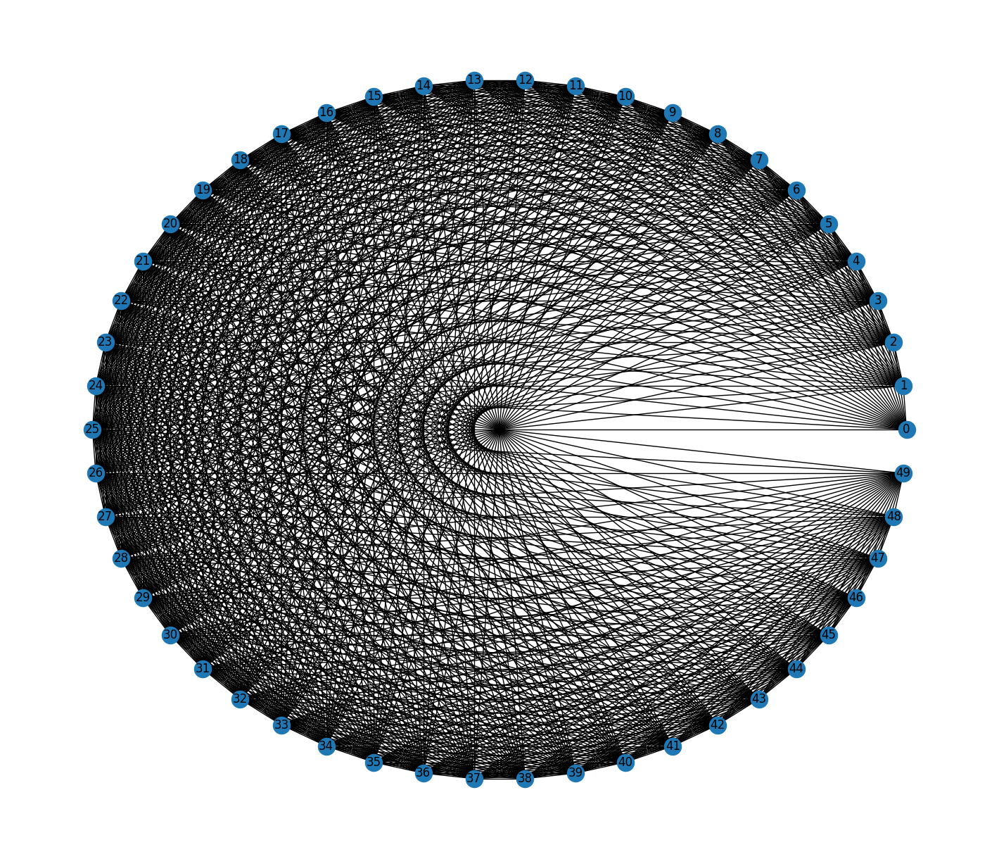

	 Randomly selected predicted value: tensor([[-0.2302]]), true value: tensor([[0.3087]])
	 Randomly selected predicted value: tensor([[-0.1100]]), true value: tensor([[-0.5141]])
	 Randomly selected predicted value: tensor([[-0.2828]]), true value: tensor([[-0.7594]])
	 Randomly selected predicted value: tensor([[-0.1911]]), true value: tensor([[0.2891]])
	 Validation loss: 0.16049497682889974
	 Validation Correlation: 0.033443311552845745
End of epoch: 7. Total run time: 2206 seconds
	 Train loss: 0.1658388461631078


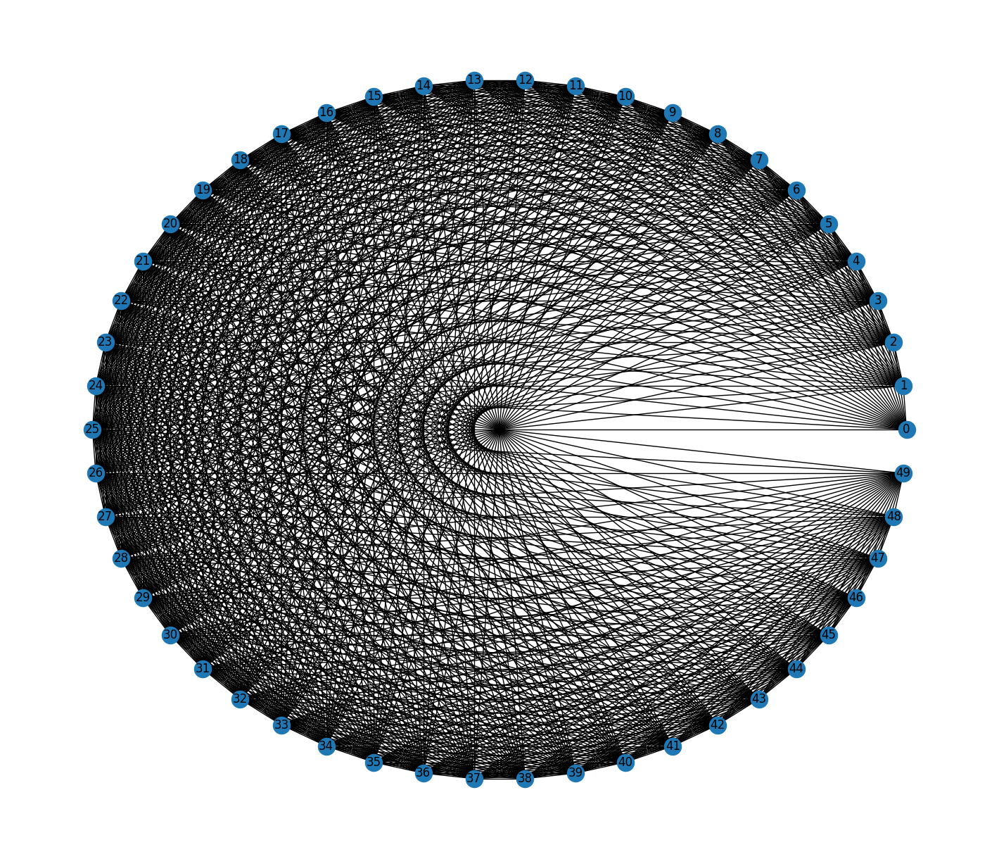

	 Randomly selected predicted value: tensor([[0.0606]]), true value: tensor([[-0.5780]])
	 Randomly selected predicted value: tensor([[-0.0964]]), true value: tensor([[-0.0723]])
	 Randomly selected predicted value: tensor([[-0.0806]]), true value: tensor([[-0.5467]])
	 Validation loss: 0.15758423756345008
	 Validation Correlation: 0.028543668116504092
End of epoch: 8. Total run time: 2486 seconds
	 Train loss: 0.1671736743587714


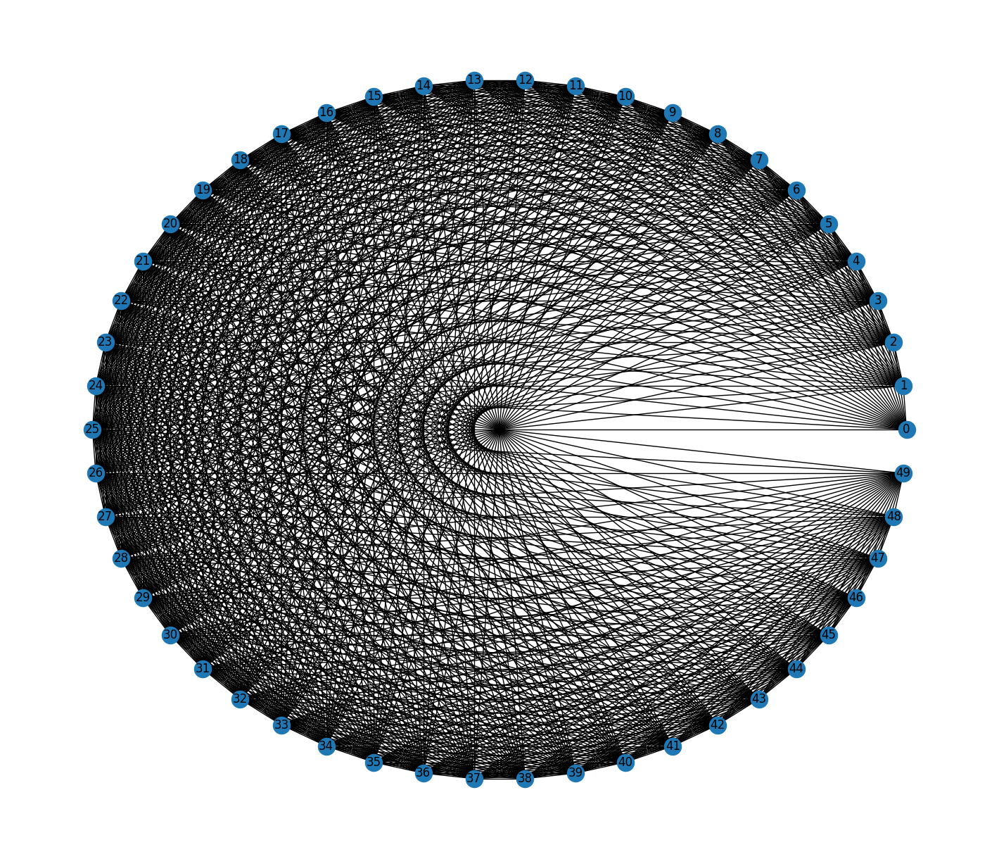

	 Randomly selected predicted value: tensor([[0.0303]]), true value: tensor([[0.3162]])
	 Randomly selected predicted value: tensor([[0.2008]]), true value: tensor([[-0.3631]])
	 Randomly selected predicted value: tensor([[0.0308]]), true value: tensor([[-0.4107]])
	 Randomly selected predicted value: tensor([[-0.1078]]), true value: tensor([[-0.4397]])
	 Randomly selected predicted value: tensor([[-0.1295]]), true value: tensor([[-0.0926]])
	 Randomly selected predicted value: tensor([[-0.0222]]), true value: tensor([[-0.2252]])
	 Validation loss: 0.157022219192834
	 Validation Correlation: 0.03428379535279964
End of epoch: 9. Total run time: 2767 seconds
	 Train loss: 0.16167494133114815


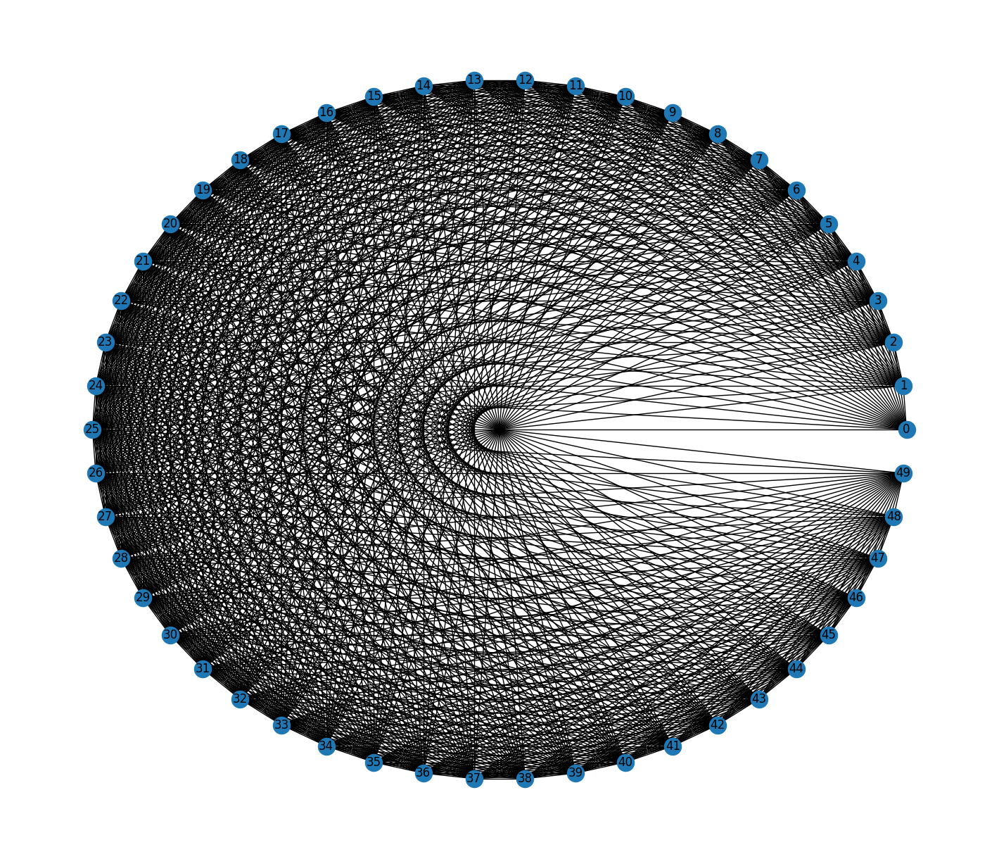

	 Randomly selected predicted value: tensor([[-0.3298]]), true value: tensor([[-0.2907]])
	 Randomly selected predicted value: tensor([[-0.2317]]), true value: tensor([[0.0028]])
	 Randomly selected predicted value: tensor([[-0.3025]]), true value: tensor([[-0.2630]])
	 Randomly selected predicted value: tensor([[-0.2976]]), true value: tensor([[0.6940]])
	 Randomly selected predicted value: tensor([[-0.1926]]), true value: tensor([[-0.2743]])
	 Randomly selected predicted value: tensor([[-0.2964]]), true value: tensor([[-0.6350]])
	 Randomly selected predicted value: tensor([[-0.2800]]), true value: tensor([[-0.2114]])
	 Randomly selected predicted value: tensor([[-0.0755]]), true value: tensor([[0.1524]])
	 Randomly selected predicted value: tensor([[-0.1939]]), true value: tensor([[-0.3818]])
	 Validation loss: 0.1616971823087175
	 Validation Correlation: 0.03307384018447942
End of epoch: 10. Total run time: 3048 seconds
	 Train loss: 0.15911756887649878


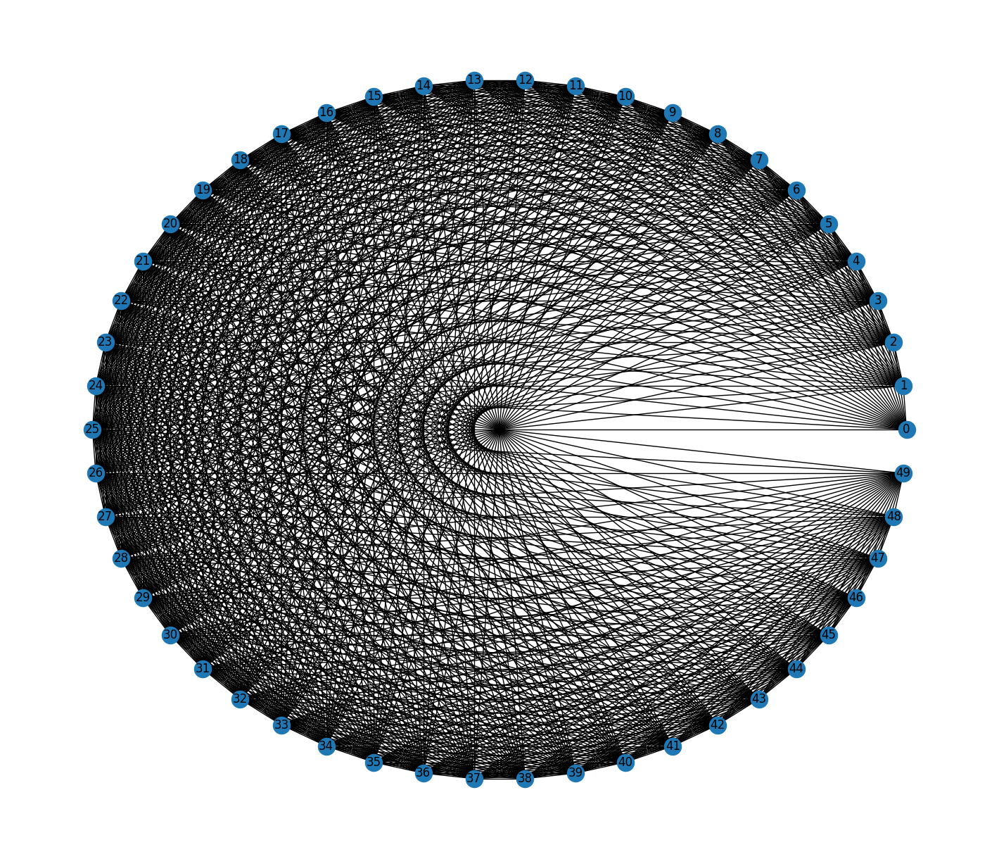

	 Randomly selected predicted value: tensor([[-0.0588]]), true value: tensor([[-0.0304]])
	 Randomly selected predicted value: tensor([[-0.1790]]), true value: tensor([[-0.4227]])
	 Randomly selected predicted value: tensor([[-0.0233]]), true value: tensor([[-0.4929]])
	 Randomly selected predicted value: tensor([[-0.0544]]), true value: tensor([[-0.8085]])
	 Validation loss: 0.1558629948292545
	 Validation Correlation: 0.04498063108251223
End of epoch: 11. Total run time: 3330 seconds
	 Train loss: 0.15937183157373697


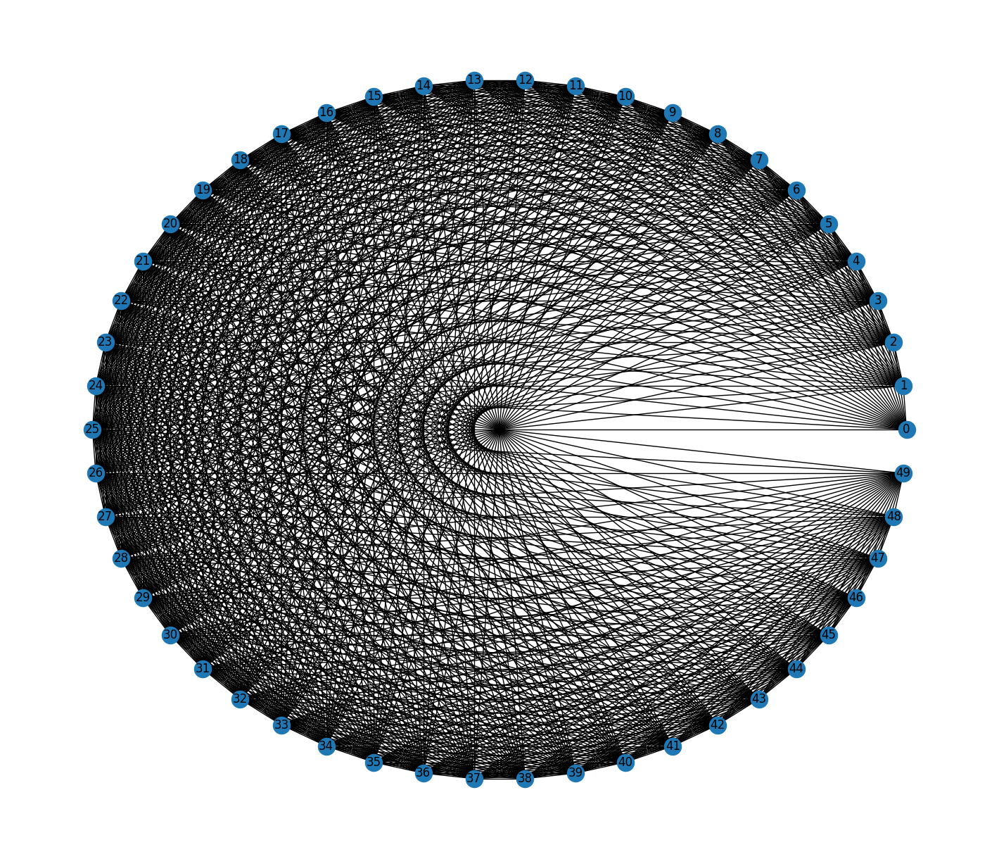

	 Randomly selected predicted value: tensor([[-0.2878]]), true value: tensor([[-0.1404]])
	 Randomly selected predicted value: tensor([[-0.1267]]), true value: tensor([[-0.7244]])
	 Randomly selected predicted value: tensor([[-0.0992]]), true value: tensor([[0.1566]])
	 Randomly selected predicted value: tensor([[-0.2436]]), true value: tensor([[-0.6794]])
	 Randomly selected predicted value: tensor([[-0.1576]]), true value: tensor([[0.1727]])
	 Randomly selected predicted value: tensor([[-0.0643]]), true value: tensor([[-0.3370]])
	 Randomly selected predicted value: tensor([[0.0612]]), true value: tensor([[0.3914]])
	 Randomly selected predicted value: tensor([[-0.2022]]), true value: tensor([[-0.3516]])
	 Randomly selected predicted value: tensor([[-0.1037]]), true value: tensor([[-0.0649]])
	 Randomly selected predicted value: tensor([[-0.3462]]), true value: tensor([[0.1357]])
	 Validation loss: 0.15341601557134646
	 Validation Correlation: 0.04053471675542748
End of epoch: 12. To

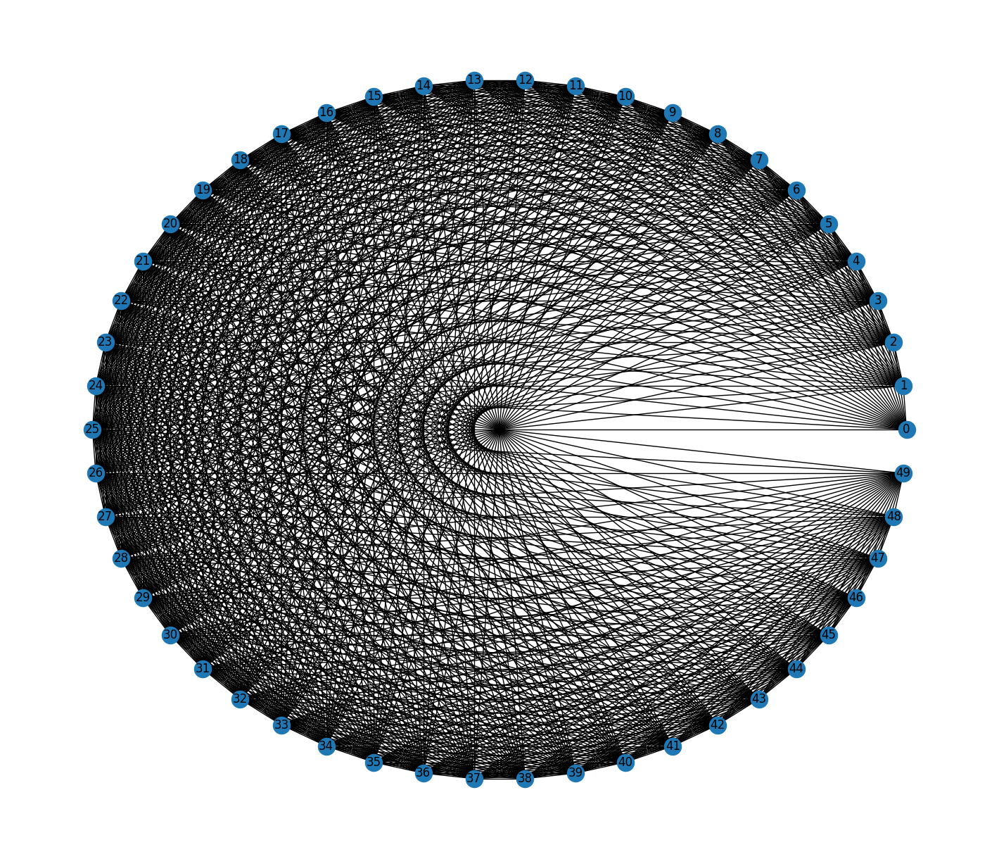

	 Randomly selected predicted value: tensor([[0.1669]]), true value: tensor([[-0.2812]])
	 Randomly selected predicted value: tensor([[-0.0026]]), true value: tensor([[0.1194]])
	 Randomly selected predicted value: tensor([[0.0749]]), true value: tensor([[-0.2403]])
	 Randomly selected predicted value: tensor([[0.2093]]), true value: tensor([[0.0742]])
	 Randomly selected predicted value: tensor([[0.2010]]), true value: tensor([[-0.2561]])
	 Randomly selected predicted value: tensor([[0.0944]]), true value: tensor([[0.3941]])
	 Validation loss: 0.19522240235328725
	 Validation Correlation: 0.03236041025775109
End of epoch: 13. Total run time: 3893 seconds
	 Train loss: 0.15669278922753457


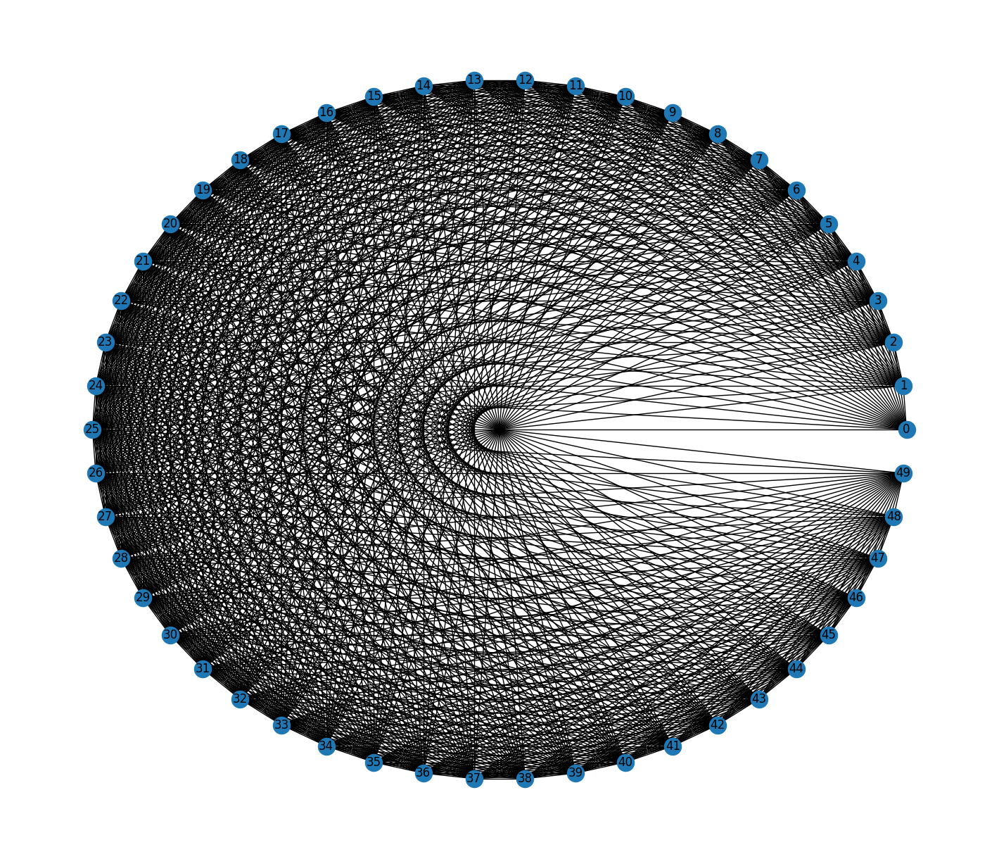

	 Randomly selected predicted value: tensor([[-0.4306]]), true value: tensor([[-0.7222]])
	 Randomly selected predicted value: tensor([[-0.1997]]), true value: tensor([[0.7874]])
	 Randomly selected predicted value: tensor([[-0.0647]]), true value: tensor([[-0.5270]])
	 Randomly selected predicted value: tensor([[-0.1663]]), true value: tensor([[-0.0422]])
	 Randomly selected predicted value: tensor([[-0.3565]]), true value: tensor([[0.2364]])
	 Randomly selected predicted value: tensor([[-0.3880]]), true value: tensor([[-0.1208]])
	 Randomly selected predicted value: tensor([[-0.2921]]), true value: tensor([[0.0954]])
	 Randomly selected predicted value: tensor([[0.1851]]), true value: tensor([[-0.3570]])
	 Validation loss: 0.19263252636113465
	 Validation Correlation: 0.024433649885790554
End of epoch: 14. Total run time: 4174 seconds
	 Train loss: 0.1581273228694231


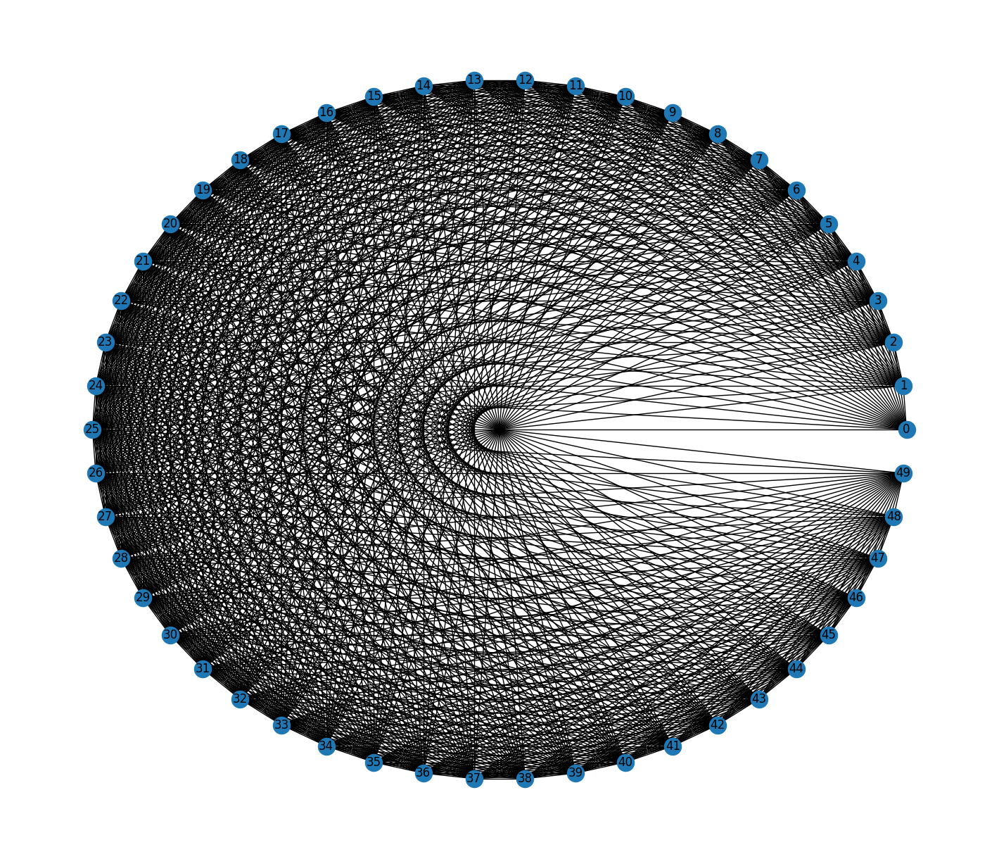

	 Randomly selected predicted value: tensor([[-0.0132]]), true value: tensor([[-0.2137]])
	 Randomly selected predicted value: tensor([[-0.1601]]), true value: tensor([[0.2739]])
	 Randomly selected predicted value: tensor([[-0.2100]]), true value: tensor([[0.0610]])
	 Randomly selected predicted value: tensor([[-0.1536]]), true value: tensor([[0.2168]])
	 Randomly selected predicted value: tensor([[-0.2242]]), true value: tensor([[-0.4876]])
	 Randomly selected predicted value: tensor([[-0.3137]]), true value: tensor([[-0.4882]])
	 Randomly selected predicted value: tensor([[-0.1137]]), true value: tensor([[-0.2664]])
	 Randomly selected predicted value: tensor([[-0.1629]]), true value: tensor([[-0.2848]])
	 Randomly selected predicted value: tensor([[-0.0726]]), true value: tensor([[-0.2850]])
	 Validation loss: 0.15004003312044192
	 Validation Correlation: 0.044665581225738514
End of epoch: 15. Total run time: 4455 seconds
	 Train loss: 0.15695936733331436


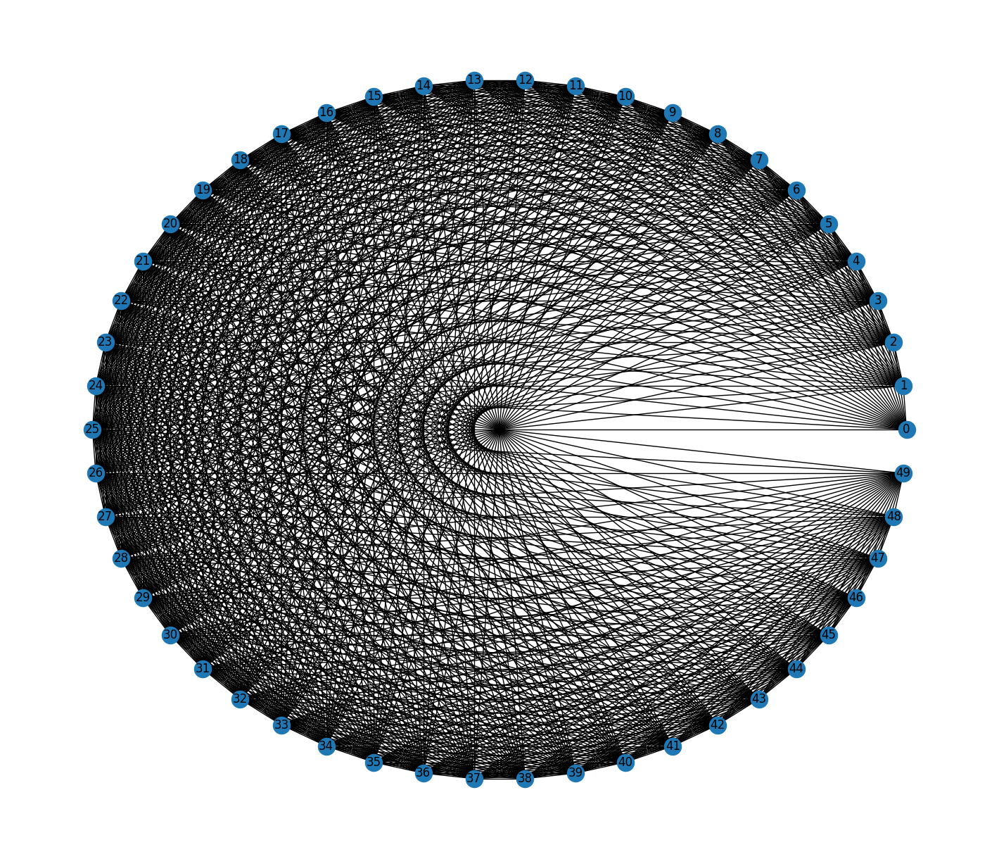

	 Randomly selected predicted value: tensor([[0.0701]]), true value: tensor([[0.4862]])
	 Randomly selected predicted value: tensor([[0.0620]]), true value: tensor([[-0.1383]])
	 Randomly selected predicted value: tensor([[0.2333]]), true value: tensor([[0.0667]])
	 Randomly selected predicted value: tensor([[0.0475]]), true value: tensor([[-0.1607]])
	 Randomly selected predicted value: tensor([[0.0183]]), true value: tensor([[0.0288]])
	 Randomly selected predicted value: tensor([[-0.0465]]), true value: tensor([[0.8235]])
	 Randomly selected predicted value: tensor([[-0.0779]]), true value: tensor([[0.4679]])
	 Randomly selected predicted value: tensor([[0.0027]]), true value: tensor([[-0.2023]])
	 Randomly selected predicted value: tensor([[-0.0389]]), true value: tensor([[0.0468]])
	 Validation loss: 0.16671050990864175
	 Validation Correlation: 0.045143902919882815
End of epoch: 16. Total run time: 4738 seconds
	 Train loss: 0.1542310961928123


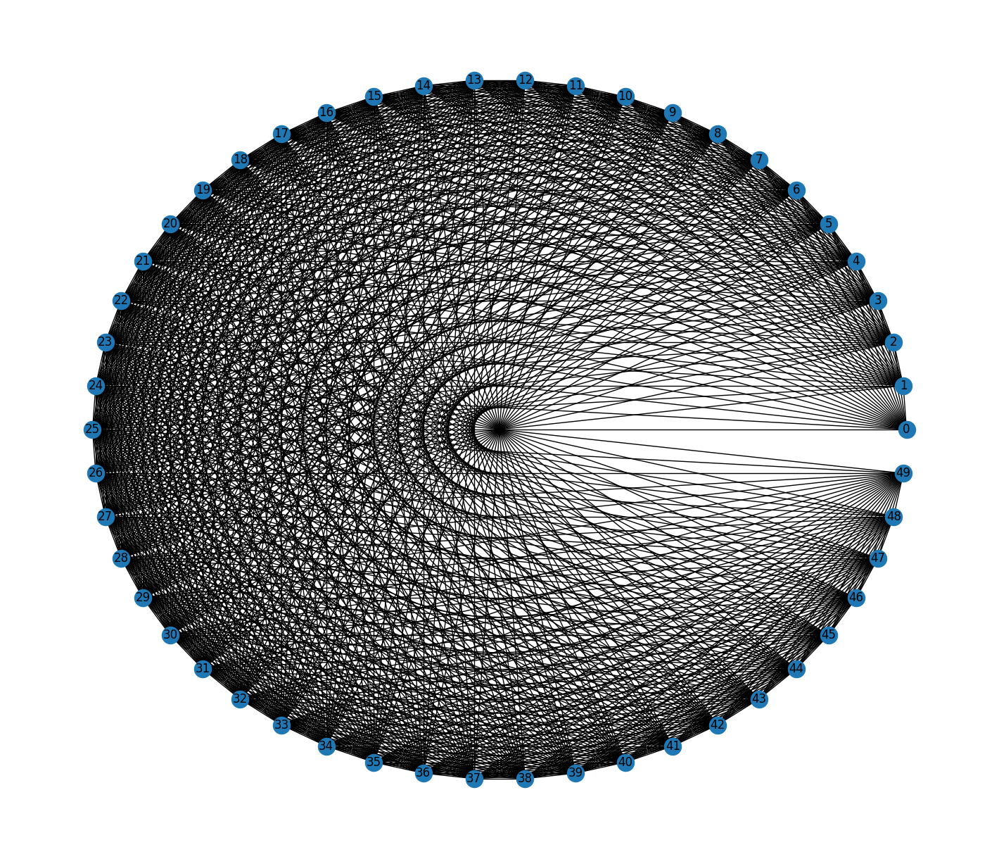

	 Randomly selected predicted value: tensor([[-0.1479]]), true value: tensor([[-0.3212]])
	 Randomly selected predicted value: tensor([[-0.1342]]), true value: tensor([[-0.4828]])
	 Randomly selected predicted value: tensor([[0.1115]]), true value: tensor([[-0.2760]])
	 Randomly selected predicted value: tensor([[-0.0512]]), true value: tensor([[-0.2515]])
	 Randomly selected predicted value: tensor([[0.0106]]), true value: tensor([[0.1629]])
	 Validation loss: 0.1637750143511358
	 Validation Correlation: 0.03576037691175021
End of epoch: 17. Total run time: 5019 seconds
	 Train loss: 0.15396887745039586


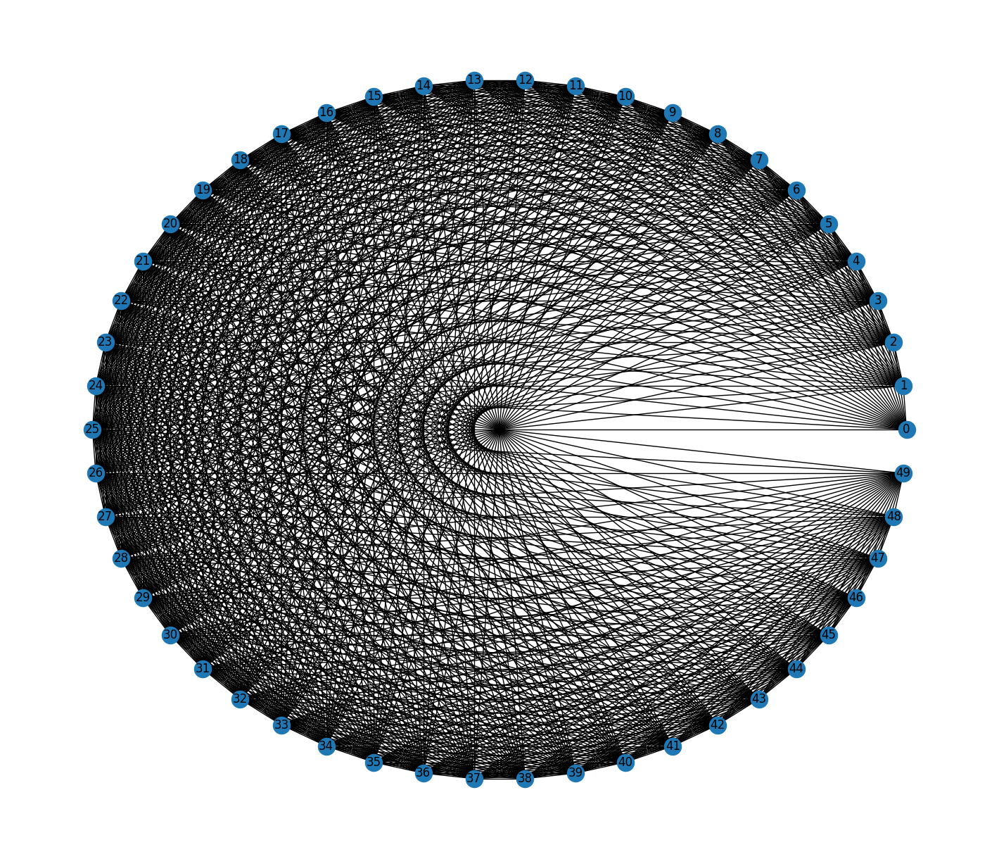

	 Randomly selected predicted value: tensor([[0.0789]]), true value: tensor([[-0.4857]])
	 Randomly selected predicted value: tensor([[0.1248]]), true value: tensor([[-0.0142]])
	 Randomly selected predicted value: tensor([[0.1442]]), true value: tensor([[0.1277]])
	 Validation loss: 0.19326630331852668
	 Validation Correlation: 0.04225037563314181
End of epoch: 18. Total run time: 5300 seconds
	 Train loss: 0.15501162847265218


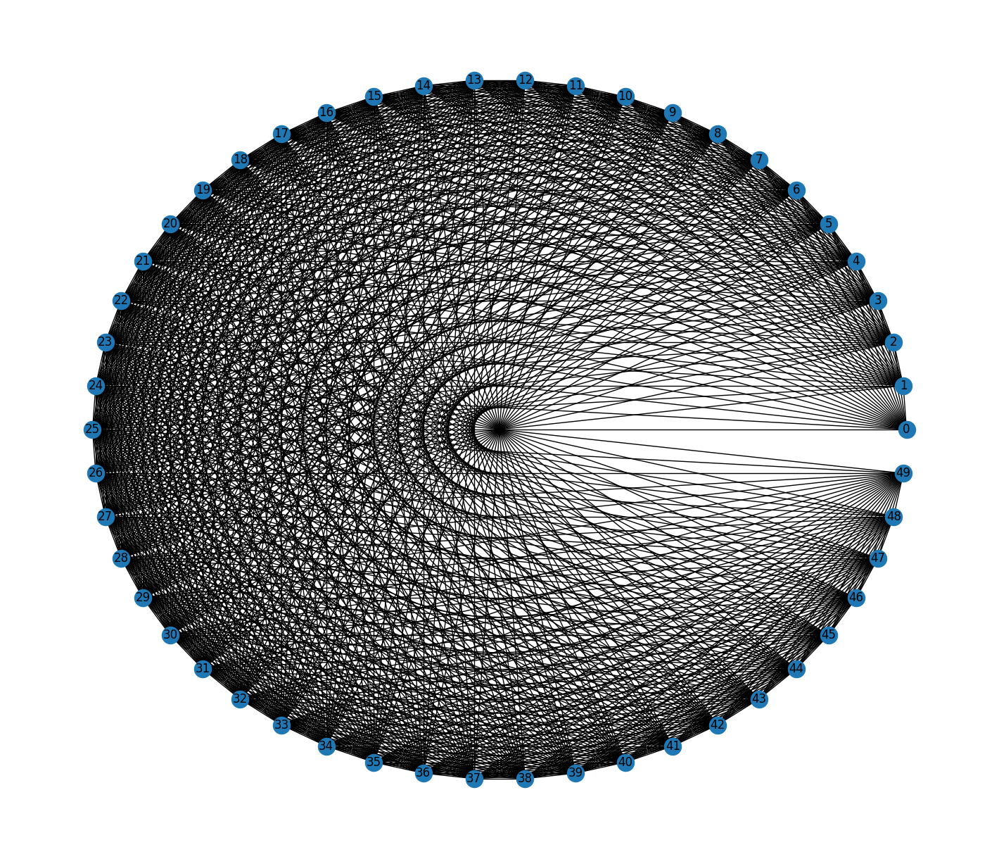

	 Randomly selected predicted value: tensor([[-0.1584]]), true value: tensor([[0.0301]])
	 Randomly selected predicted value: tensor([[-0.1699]]), true value: tensor([[-0.4331]])
	 Validation loss: 0.1516012290568931
	 Validation Correlation: 0.05599729016356666
End of epoch: 19. Total run time: 5580 seconds
	 Train loss: 0.1557606142682907


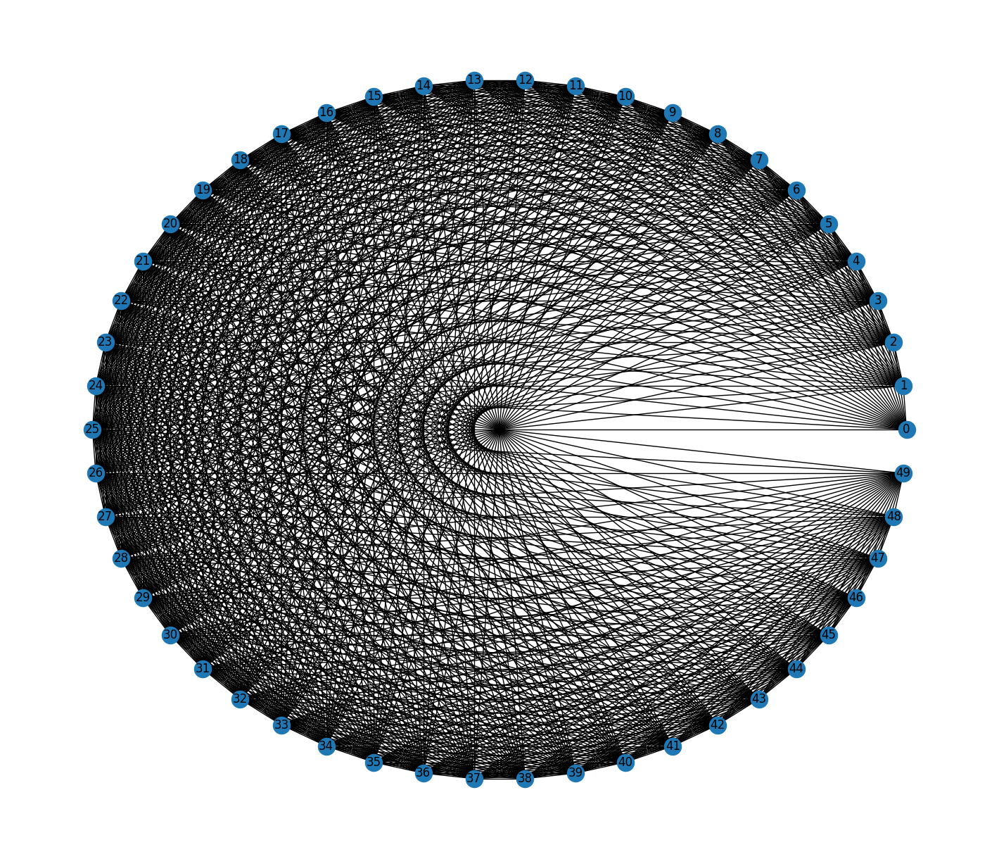

	 Randomly selected predicted value: tensor([[-0.0574]]), true value: tensor([[-0.3178]])
	 Randomly selected predicted value: tensor([[-0.0243]]), true value: tensor([[-0.6184]])
	 Randomly selected predicted value: tensor([[-0.1861]]), true value: tensor([[-0.2120]])
	 Randomly selected predicted value: tensor([[-0.0387]]), true value: tensor([[-0.1744]])
	 Randomly selected predicted value: tensor([[-0.1195]]), true value: tensor([[-0.1474]])
	 Randomly selected predicted value: tensor([[-0.1065]]), true value: tensor([[0.1732]])
	 Randomly selected predicted value: tensor([[-0.1195]]), true value: tensor([[1.3732]])
	 Randomly selected predicted value: tensor([[-0.1251]]), true value: tensor([[-0.5826]])
	 Randomly selected predicted value: tensor([[-0.2772]]), true value: tensor([[-0.7087]])
	 Validation loss: 0.14650492935264448
	 Validation Correlation: 0.07214903986920593


In [5]:
hyperparameters = {"hidden_channels":128, "num_layers":[3], "num_epochs":20, "learning_rate":0.00001, "batch_size":32,
                   "pool_ratios":[], "pool_types":[], "mlp_num_layers":2}
logging_info = {"print_every":1}

model, train_loss, val_loss, val_corr = train(random_data, model_name="GraphSAGE", hyperparameters=hyperparameters, 
                                              logging_info=logging_info, val_data=random_data, plot_0_val=True)

# Notes:

Learning rate of 0.1 - immediate mode collapse

Learning rate of 0.001 - no mode collapse but not great (seems to jump from all positive to all negative and vice versa)

Learning rate of 0.00001 - 




Could try MLP from (50,64) -> (50,1) then global add pool from (50,1) -> (1,1) for final result rather than what I have now:
Global add pool from (50,64) -> (1,64) then MLP from (1,64) -> (1,1)

Could also just do a fully connected layer to replace global pooling (Linear from (50,1) -> (1,1))